# EDA on NYC Taxi Tip Data

In [0]:
# Load data
from pyspark.sql import SparkSession

spark = SparkSession.builder.appName("NYC Taxi Tip EDA").getOrCreate()
df = spark.read.csv("/FileStore/tables/NYC_Taxi_Trip_Record_Clean.csv", header=True, inferSchema=True)
df.cache()

Out[1]: DataFrame[lpep_pickup_datetime: string, lpep_dropoff_datetime: string, day_category: string, pickup_time: string, RatecodeID: string, PULocationID: int, PUBorough: string, PUZone: string, DOLocationID: int, DOBorough: string, DOZone: string, passenger_count: string, trip_distance: double, distance_bins: string, fare_amount: double, fare_amount_bins: string, tip_amount: double, tip_amount_bins: string, payment_type: string, trip_type: string, trip_duration: double, duration_bins: string, speed: double, speed_bins: string]

In [0]:
# 2. 
df.printSchema()

root
 |-- lpep_pickup_datetime: string (nullable = true)
 |-- lpep_dropoff_datetime: string (nullable = true)
 |-- day_category: string (nullable = true)
 |-- pickup_time: string (nullable = true)
 |-- RatecodeID: string (nullable = true)
 |-- PULocationID: integer (nullable = true)
 |-- PUBorough: string (nullable = true)
 |-- PUZone: string (nullable = true)
 |-- DOLocationID: integer (nullable = true)
 |-- DOBorough: string (nullable = true)
 |-- DOZone: string (nullable = true)
 |-- passenger_count: string (nullable = true)
 |-- trip_distance: double (nullable = true)
 |-- distance_bins: string (nullable = true)
 |-- fare_amount: double (nullable = true)
 |-- fare_amount_bins: string (nullable = true)
 |-- tip_amount: double (nullable = true)
 |-- tip_amount_bins: string (nullable = true)
 |-- payment_type: string (nullable = true)
 |-- trip_type: string (nullable = true)
 |-- trip_duration: double (nullable = true)
 |-- duration_bins: string (nullable = true)
 |-- speed: double (n

In [0]:

df.display(5)

lpep_pickup_datetime,lpep_dropoff_datetime,day_category,pickup_time,RatecodeID,PULocationID,PUBorough,PUZone,DOLocationID,DOBorough,DOZone,passenger_count,trip_distance,distance_bins,fare_amount,fare_amount_bins,tip_amount,tip_amount_bins,payment_type,trip_type,trip_duration,duration_bins,speed,speed_bins
01-01-2023 0.26,01-01-2023 0.37,Weekend,Midnight,Standard rate,166,Manhattan,Morningside Heights,143,Manhattan,Lincoln Square West,1,2.58,3-6 miles,14.9,<20$,4.03,1-5$,Credit card,Street-hail,11.02,11-20 minutes,14.05,11-20 mph
01-01-2023 0.51,01-01-2023 0.57,Weekend,Midnight,Standard rate,24,Manhattan,Bloomingdale,43,Manhattan,Central Park,1,1.81,<2 miles,10.7,<20$,2.64,1-5$,Credit card,Street-hail,6.77,<10 minutes,16.04,11-20 mph
01-01-2023 0.13,01-01-2023 0.19,Weekend,Midnight,Standard rate,41,Manhattan,Central Harlem,238,Manhattan,Upper West Side North,1,1.3,<2 miles,6.5,<20$,1.7,1-5$,Credit card,Street-hail,5.82,<10 minutes,13.4,11-20 mph
01-01-2023 0.33,01-01-2023 0.39,Weekend,Midnight,Standard rate,41,Manhattan,Central Harlem,74,Manhattan,East Harlem North,1,1.1,<2 miles,6.0,<20$,0.0,0$,Credit card,Street-hail,5.97,<10 minutes,11.06,11-20 mph
01-01-2023 0.53,01-01-2023 1.11,Weekend,Midnight,Standard rate,41,Manhattan,Central Harlem,262,Manhattan,Yorkville East,1,2.78,3-6 miles,17.7,<20$,0.0,0$,Cash,Street-hail,17.55,11-20 minutes,9.5,<10 mph
01-01-2023 0.09,01-01-2023 0.26,Weekend,Midnight,Standard rate,181,Brooklyn,Park Slope,45,Manhattan,Chinatown,2,3.8,3-6 miles,19.1,<20$,4.85,1-5$,Credit card,Street-hail,17.42,11-20 minutes,13.09,11-20 mph
01-01-2023 0.11,01-01-2023 0.24,Weekend,Midnight,Standard rate,24,Manhattan,Bloomingdale,75,Manhattan,East Harlem South,1,1.88,<2 miles,14.2,<20$,0.0,0$,Cash,Street-hail,12.95,11-20 minutes,8.71,<10 mph
01-01-2023 0.41,01-01-2023 0.46,Weekend,Midnight,Standard rate,41,Manhattan,Central Harlem,166,Manhattan,Morningside Heights,2,1.11,<2 miles,7.2,<20$,1.0,1-5$,Credit card,Street-hail,4.95,<10 minutes,13.45,11-20 mph
01-01-2023 0.50,01-01-2023 1.13,Weekend,Midnight,Standard rate,24,Manhattan,Bloomingdale,140,Manhattan,Lenox Hill East,1,4.22,3-6 miles,24.7,21-40$,3.0,1-5$,Credit card,Street-hail,23.17,21-30 minutes,10.93,11-20 mph
01-01-2023 0.16,01-01-2023 0.41,Weekend,Midnight,Standard rate,255,Brooklyn,Williamsburg (North Side),234,Manhattan,Union Sq,2,4.8,3-6 miles,26.8,21-40$,0.0,0$,Credit card,Street-hail,25.52,21-30 minutes,11.29,11-20 mph


In [0]:

df.count()

Out[4]: 60698

In [0]:
# 5. Get summary statistics (count, mean, stddev, min, max) of numeric columns?

df.describe().display()

summary,lpep_pickup_datetime,lpep_dropoff_datetime,day_category,pickup_time,RatecodeID,PULocationID,PUBorough,PUZone,DOLocationID,DOBorough,DOZone,passenger_count,trip_distance,distance_bins,fare_amount,fare_amount_bins,tip_amount,tip_amount_bins,payment_type,trip_type,trip_duration,duration_bins,speed,speed_bins
count,60698,60698,60698,60698,60698,60698,60698,60698,60698,60698,60698,60698,60698,60698,60698,60698,60698,60698,60698,60698,60698,60698,60698,60698
mean,null,null,null,null,null,97.28895515502983,null,null,139.7581633661735,null,null,1.1081666233653762,2.9098363208013485,null,16.772223796500782,null,2.2597301393785663,null,null,null,14.051646017990734,null,12.11560463277198,null
stddev,null,null,null,null,null,59.656318498654784,null,null,76.07590197793792,null,null,0.3549895606902233,2.6465367616248243,null,10.834099451817593,null,2.7108688030516888,null,null,null,9.253346907328678,null,5.151361349206878,null
min,01-01-2023 0.01,01-01-2023 0.13,Weekdays,Evening,JFK Airport,3,Bronx,Allerton/Pelham Gardens,1,Bronx,Allerton/Pelham Gardens,1,0.63,3-6 miles,2.5,21-40$,0.0,0$,Cash,Dispatch,2.02,11-20 minutes,5.0,11-20 mph
max,31-01-2023 9.58,31-01-2023 9.59,Weekend,Noon,Standard rate,263,Staten Island,Yorkville West,263,Staten Island,Yorkville West,>3,41.74,>10 miles,161.2,>60$,50.0,>15$,Unknown,Street-hail,172.48,>30 minutes,60.05,>30 mph


In [0]:
# 6. Calculate average tip amount grouped by passenger count
# TODO: Write the code to answer the above question

df.groupBy("passenger_count") \
  .avg("tip_amount") \
  .withColumnRenamed("avg(tip_amount)", "average_tip_amount") \
  .orderBy("passenger_count") \
  .display()

passenger_count,average_tip_amount
1,2.2478845308828332
2,2.2726701916721734
3,2.309636576787808
>3,2.434799190010125


In [0]:
# 7. Calculate total tip amount by payment type
# TODO: Write the code to answer the above question
df.groupBy("payment_type") \
  .sum("tip_amount") \
  .withColumnRenamed("sum(tip_amount)", "total_tip_amount") \
  .orderBy("total_tip_amount", ascending=False) \
  .display()


payment_type,total_tip_amount
Credit card,137161.1000000002
Cash,0.0
Dispute,0.0
No charge,0.0
Unknown,0.0


In [0]:
# 8. Display records where the tip amount is greater than 5
# TODO: Write the code to answer the above question
df.filter(df.tip_amount > 5).display()


lpep_pickup_datetime,lpep_dropoff_datetime,day_category,pickup_time,RatecodeID,PULocationID,PUBorough,PUZone,DOLocationID,DOBorough,DOZone,passenger_count,trip_distance,distance_bins,fare_amount,fare_amount_bins,tip_amount,tip_amount_bins,payment_type,trip_type,trip_duration,duration_bins,speed,speed_bins
01-01-2023 0.40,01-01-2023 1.04,Weekend,Midnight,Negotiated fare,66,Brooklyn,DUMBO/Vinegar Hill,164,Manhattan,Midtown South,>3,6.78,7-10 miles,60.0,41-60$,12.61,11-15$,Credit card,Dispatch,23.57,21-30 minutes,17.26,11-20 mph
01-01-2023 0.46,01-01-2023 0.59,Weekend,Midnight,Standard rate,75,Manhattan,East Harlem South,143,Manhattan,Lincoln Square West,1,3.19,3-6 miles,15.6,<20$,6.26,6-10$,Credit card,Street-hail,13.03,11-20 minutes,14.69,11-20 mph
01-01-2023 0.23,01-01-2023 0.47,Weekend,Midnight,Standard rate,255,Brooklyn,Williamsburg (North Side),48,Manhattan,Clinton East,1,8.55,7-10 miles,47.8,41-60$,5.3,6-10$,Credit card,Street-hail,24.58,21-30 minutes,20.87,21-30 mph
01-01-2023 0.34,01-01-2023 0.50,Weekend,Midnight,Standard rate,130,Queens,Jamaica,196,Queens,Rego Park,1,4.46,3-6 miles,21.2,21-40$,7.11,6-10$,Credit card,Street-hail,15.9,11-20 minutes,16.83,11-20 mph
01-01-2023 0.11,01-01-2023 0.38,Weekend,Midnight,Standard rate,65,Brooklyn,Downtown Brooklyn/MetroTech,162,Manhattan,Midtown East,2,7.3,7-10 miles,25.5,21-40$,7.55,6-10$,Credit card,Street-hail,27.0,21-30 minutes,16.22,11-20 mph
01-01-2023 1.11,01-01-2023 1.41,Weekend,Midnight,Standard rate,152,Manhattan,Manhattanville,140,Manhattan,Lenox Hill East,2,4.9,3-6 miles,26.8,21-40$,6.41,6-10$,Credit card,Street-hail,29.7,21-30 minutes,9.9,<10 mph
01-01-2023 1.23,01-01-2023 1.53,Weekend,Midnight,Standard rate,255,Brooklyn,Williamsburg (North Side),249,Manhattan,West Village,1,4.9,3-6 miles,29.6,21-40$,8.71,6-10$,Credit card,Street-hail,30.13,>30 minutes,9.76,<10 mph
01-01-2023 1.34,01-01-2023 2.00,Weekend,Midnight,Standard rate,260,Queens,Woodside,262,Manhattan,Yorkville East,1,5.2,3-6 miles,28.2,21-40$,6.69,6-10$,Credit card,Street-hail,25.42,21-30 minutes,12.27,11-20 mph
01-01-2023 1.34,01-01-2023 1.52,Weekend,Midnight,Standard rate,166,Manhattan,Morningside Heights,229,Manhattan,Sutton Place/Turtle Bay North,2,5.13,3-6 miles,25.4,21-40$,7.66,6-10$,Credit card,Street-hail,18.45,11-20 minutes,16.68,11-20 mph
01-01-2023 1.39,01-01-2023 2.00,Weekend,Midnight,Standard rate,75,Manhattan,East Harlem South,95,Queens,Forest Hills,1,11.34,>10 miles,44.3,41-60$,6.65,6-10$,Credit card,Street-hail,21.65,21-30 minutes,31.43,>30 mph


In [0]:
# 9. Identify outliers where tip amount is greater than 50?
# TODO: Write the code to answer the above question
df.filter(df.tip_amount > 50) \
  .select("fare_amount", "tip_amount", "trip_distance", "payment_type", "passenger_count") \
  .display()

fare_amount,tip_amount,trip_distance,payment_type,passenger_count


In [0]:
# 10. How to calculate the correlation between trip distance and tip amount?
# TODO: Write the code to answer the above question
correlation = df.stat.corr("trip_distance", "tip_amount")
print(f"Correlation between trip distance and tip amount: {correlation}")

Correlation between trip distance and tip amount: 0.4165306370446274


In [0]:
# 11. Get average tip amount by day of the week
# TODO: Write the code to answer the above question
from pyspark.sql.functions import dayofweek
df.withColumn("day_of_week", dayofweek(df.lpep_pickup_datetime)) \
  .groupBy("day_of_week") \
  .avg("tip_amount") \
  .withColumnRenamed("avg(tip_amount)", "average_tip_amount") \
  .orderBy("day_of_week") \
  .display()

day_of_week,average_tip_amount
null,2.2597301393785663


In [0]:
# 12. Get average tip amount by hour of the day
# TODO: Write the code to answer the above question
from pyspark.sql.functions import hour
df.withColumn("hour_of_day", hour(df.lpep_pickup_datetime)) \
  .groupBy("hour_of_day") \
  .avg("tip_amount") \
  .withColumnRenamed("avg(tip_amount)", "average_tip_amount") \
  .orderBy("hour_of_day") \
  .display()


hour_of_day,average_tip_amount
null,2.2597301393785663


In [0]:
# 13. Calculate tip amount per mile and describe its statistics
# TODO: Write the code to answer the above question
from pyspark.sql.functions import col
df_with_tip_per_mile = df.withColumn("tip_per_mile", col("tip_amount") / col("trip_distance"))

# Get summary statistics
df_with_tip_per_mile.select("tip_per_mile").describe().display()


summary,tip_per_mile
count,60698
mean,0.9462572701376127
stddev,0.9968029260390485
min,0.0
max,17.857142857142858


In [0]:
# 14. Get records with invalid fare or tip amounts. Then remove these invalid records from dataframe (make it clean)
# TODO: Write the code to answer the above question
invalid_records = df.filter((df.fare_amount <= 0) | (df.tip_amount <= 0))

# Show the invalid records
invalid_records.display()


lpep_pickup_datetime,lpep_dropoff_datetime,day_category,pickup_time,RatecodeID,PULocationID,PUBorough,PUZone,DOLocationID,DOBorough,DOZone,passenger_count,trip_distance,distance_bins,fare_amount,fare_amount_bins,tip_amount,tip_amount_bins,payment_type,trip_type,trip_duration,duration_bins,speed,speed_bins
01-01-2023 0.33,01-01-2023 0.39,Weekend,Midnight,Standard rate,41,Manhattan,Central Harlem,74,Manhattan,East Harlem North,1,1.1,<2 miles,6.0,<20$,0.0,0$,Credit card,Street-hail,5.97,<10 minutes,11.06,11-20 mph
01-01-2023 0.53,01-01-2023 1.11,Weekend,Midnight,Standard rate,41,Manhattan,Central Harlem,262,Manhattan,Yorkville East,1,2.78,3-6 miles,17.7,<20$,0.0,0$,Cash,Street-hail,17.55,11-20 minutes,9.5,<10 mph
01-01-2023 0.11,01-01-2023 0.24,Weekend,Midnight,Standard rate,24,Manhattan,Bloomingdale,75,Manhattan,East Harlem South,1,1.88,<2 miles,14.2,<20$,0.0,0$,Cash,Street-hail,12.95,11-20 minutes,8.71,<10 mph
01-01-2023 0.16,01-01-2023 0.41,Weekend,Midnight,Standard rate,255,Brooklyn,Williamsburg (North Side),234,Manhattan,Union Sq,2,4.8,3-6 miles,26.8,21-40$,0.0,0$,Credit card,Street-hail,25.52,21-30 minutes,11.29,11-20 mph
01-01-2023 0.39,01-01-2023 1.18,Weekend,Midnight,Standard rate,255,Brooklyn,Williamsburg (North Side),186,Manhattan,Penn Station/Madison Sq West,1,5.91,3-6 miles,35.9,21-40$,0.0,0$,Cash,Street-hail,38.57,>30 minutes,9.19,<10 mph
01-01-2023 0.49,01-01-2023 1.08,Weekend,Midnight,Standard rate,195,Brooklyn,Red Hook,210,Brooklyn,Sheepshead Bay,1,11.3,>10 miles,32.5,21-40$,0.0,0$,Cash,Street-hail,18.82,11-20 minutes,36.03,>30 mph
01-01-2023 0.10,01-01-2023 0.19,Weekend,Midnight,Negotiated fare,83,Queens,Elmhurst/Maspeth,129,Queens,Jackson Heights,1,1.3,<2 miles,15.0,<20$,0.0,0$,Credit card,Dispatch,8.87,<10 minutes,8.79,<10 mph
01-01-2023 0.31,01-01-2023 0.42,Weekend,Midnight,Standard rate,7,Queens,Astoria,260,Queens,Woodside,1,2.02,3-6 miles,12.8,<20$,0.0,0$,Cash,Street-hail,11.28,11-20 minutes,10.74,11-20 mph
01-01-2023 0.14,01-01-2023 0.21,Weekend,Midnight,Standard rate,41,Manhattan,Central Harlem,75,Manhattan,East Harlem South,1,0.96,<2 miles,8.6,<20$,0.0,0$,Cash,Street-hail,7.22,<10 minutes,7.98,<10 mph
01-01-2023 0.32,01-01-2023 0.41,Weekend,Midnight,Standard rate,41,Manhattan,Central Harlem,24,Manhattan,Bloomingdale,>3,1.51,<2 miles,11.4,<20$,0.0,0$,Cash,Street-hail,9.38,<10 minutes,9.66,<10 mph


In [0]:
# 15. Calculate average tip by trip_time
# TODO: Write the code to answer the above question
df.groupBy("trip_duration") \
  .avg("tip_amount") \
  .withColumnRenamed("avg(tip_amount)", "average_tip_amount") \
  .orderBy("trip_duration") \
  .display()


trip_duration,average_tip_amount
2.02,0.0
2.03,1.52
2.05,1.5
2.07,1.26
2.1,0.44
2.12,1.4100000000000001
2.13,1.46
2.15,1.31
2.17,1.3
2.18,1.0


In [0]:
# 16. Get average tip amount per hour. Show graph as visualization
# TODO: Write the code to answer the above question
from pyspark.sql.functions import hour
import matplotlib.pyplot as plt
import pandas as pd

# Step 1: Calculate the average tip amount per hour
df_hourly_tips = df.withColumn("hour_of_day", hour(df.lpep_pickup_datetime)) \
    .groupBy("hour_of_day") \
    .avg("tip_amount") \
    .withColumnRenamed("avg(tip_amount)", "average_tip_amount") \
    .orderBy("hour_of_day")

# Step 2: Convert to pandas DataFrame for plotting
df_hourly_tips_pd = df_hourly_tips.toPandas()

# Step 3: Create a plot (bar graph)
plt.figure(figsize=(10, 6))
plt.bar(df_hourly_tips_pd["hour_of_day"], df_hourly_tips_pd["average_tip_amount"], color="skyblue")
plt.xlabel("Hour of Day")
plt.ylabel("Average Tip Amount ($)")
plt.title("Average Tip Amount per Hour of the Day")
plt.xticks(df_hourly_tips_pd["hour_of_day"])  # Display all hours (0-23)
plt.grid(axis="y")

# If using a notebook like Databricks, use display() to show the plot
display(plt.gcf())  # Display the current figure

<Figure size 720x432 with 1 Axes>Error in callback <function install_repl_displayhook.<locals>.post_execute at 0x78f56168a1f0> (for post_execute):
<Figure size 720x432 with 1 Axes>

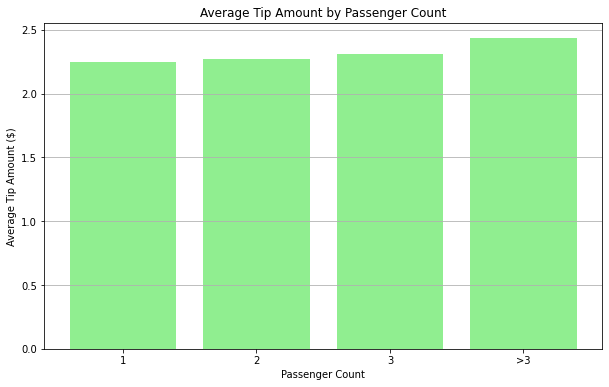

In [0]:
# 17. Get average tip by passenger count and display as bar chart
# TODO: Write the code to answer the above question
from pyspark.sql.functions import col
import matplotlib.pyplot as plt
import pandas as pd

# Step 1: Calculate the average tip by passenger count
df_avg_tip_passenger = df.groupBy("passenger_count") \
    .avg("tip_amount") \
    .withColumnRenamed("avg(tip_amount)", "average_tip_amount") \
    .orderBy("passenger_count")

# Step 2: Convert to pandas DataFrame for plotting
df_avg_tip_passenger_pd = df_avg_tip_passenger.toPandas()

# Step 3: Create a bar chart
plt.figure(figsize=(10, 6))
plt.bar(df_avg_tip_passenger_pd["passenger_count"], df_avg_tip_passenger_pd["average_tip_amount"], color="lightgreen")
plt.xlabel("Passenger Count")
plt.ylabel("Average Tip Amount ($)")
plt.title("Average Tip Amount by Passenger Count")
plt.xticks(df_avg_tip_passenger_pd["passenger_count"])  # Display all passenger counts
plt.grid(axis="y")
plt.show()


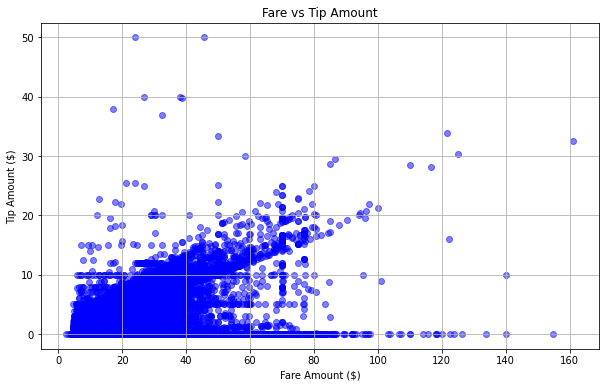

In [0]:
# 18. Get fare vs tip values and display scatter plot style visualization
# TODO: Write the code to answer the above question
import matplotlib.pyplot as plt
import pandas as pd

# Step 1: Extract the relevant columns (fare_amount and tip_amount)
df_fare_tip = df.select("fare_amount", "tip_amount")

# Convert to pandas DataFrame for plotting
df_fare_tip_pd = df_fare_tip.toPandas()

# Step 2: Create a scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(df_fare_tip_pd["fare_amount"], df_fare_tip_pd["tip_amount"], alpha=0.5, color="blue")
plt.xlabel("Fare Amount ($)")
plt.ylabel("Tip Amount ($)")
plt.title("Fare vs Tip Amount")
plt.grid(True)
plt.show()
